# Global polynomial interpolation (Lecture 4)

Last time we talked about piecewise linear interpolation, on arbitrary node sets. We showed that, for equispaced nodes , the maximum error ($\infty$ norm) of the interpolant converges quadratically with the node spacing $\Delta x$.

Can we do better than this? Particularly for "smooth" functions? This lecture is about interpolation with **polynomials**, in particular polynomials that have *global support*---i.e., that are defined on the whole input domain.

# Outline of the lecture
- Global polynomial interpolation, in a monomial basis. Finding polynomial coefficients via the Vandermonde matrix.
- Look at errors of the interpolant in various ways. How does it depend on the polynomial degree, the nodal set, and the target function?
- Better nodal sets? Chebyshev points!
- Cardinal functions for global polynomial interpolation: Lagrange interpolating polynomials

# Simple interpolation using the Vandermonde matrix

Recall our function from the last lecture:

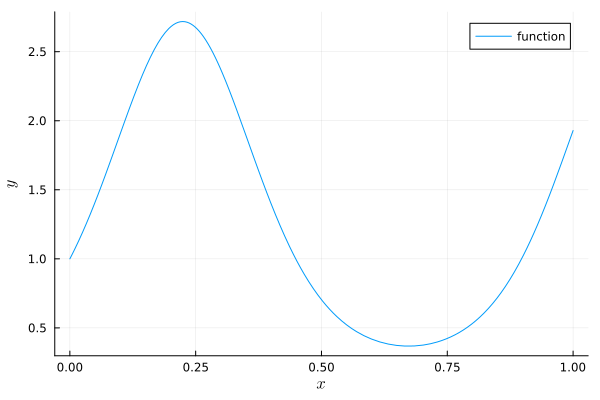

In [98]:
using Plots
using LaTeXStrings

f = x -> exp(sin(7x))

plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")

Use $n+1$ points to fit a polynomial of degree $n$:

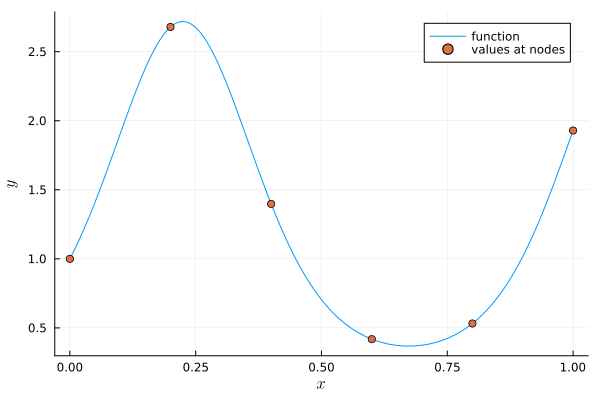

In [99]:
n = 5
t = range(0,1,n+1)
y = f.(t)
scatter!(t, y, label="values at nodes")

In [100]:
M = t .^ (0:n)' # the Vandermonde matrix

6×6 Matrix{Float64}:
 1.0  0.0  0.0   0.0    0.0     0.0
 1.0  0.2  0.04  0.008  0.0016  0.00032
 1.0  0.4  0.16  0.064  0.0256  0.01024
 1.0  0.6  0.36  0.216  0.1296  0.07776
 1.0  0.8  0.64  0.512  0.4096  0.32768
 1.0  1.0  1.0   1.0    1.0     1.0

In [101]:
c = M \ y

6-element Vector{Float64}:
    1.0
   26.186666272634014
 -125.53031682496318
  213.23924912319742
 -161.61625473116
   48.64962696470262

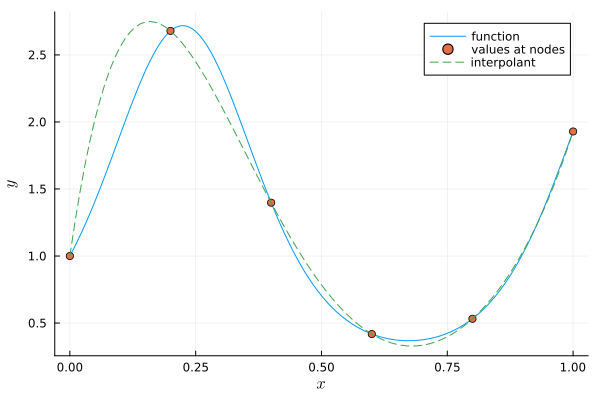

In [102]:
using Polynomials
p = Polynomial(c)
plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")
scatter!(t, y, label="values at nodes")
plot!(p, 0, 1, linestyle=:dash, label="interpolant")

OK, let's try a different $f$!

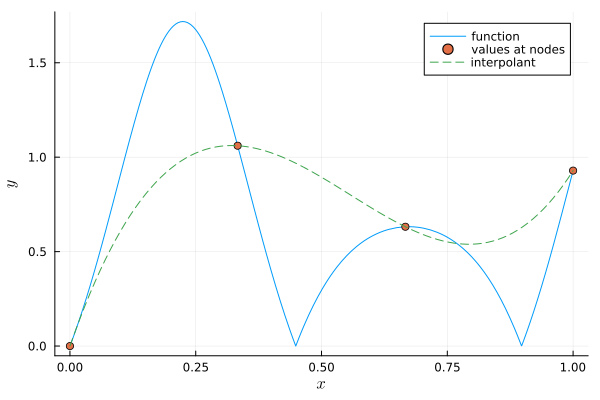

In [107]:
f = x -> abs(exp(sin(7x)) - 1 ) # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function
plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")

n = 3
t = range(0,1,n+1)
y = f.(t)

M = t .^ (0:n)' # the Vandermonde matrix
c = M \ y
p = Polynomial(c)

# c = vandermonde(t,f.(t))
# p = Polynomial(c)

scatter!(t, y, label="values at nodes")
plot!(p, 0, 1, linestyle=:dash, label="interpolant")

Can we look systematically at the error?

In [ ]:
Start with the pointwise error:

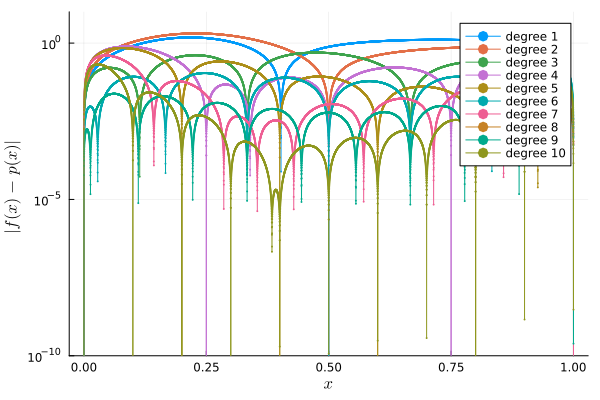

In [124]:
using LinearAlgebra
using BasicInterpolators

f = x -> exp(sin(7x))
# f = x -> abs(exp(sin(7x)) - 1)  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 1:10

plt = plot(label="", xaxis=(L"x"), yaxis=(:log10, L"|f(x)-p(x)|", [1e-10, 10]))

maxerr = zeros(length(n))
for (k,n) in enumerate(n)
    t = range(0,1,n+1)    # interpolation nodes
    c = vandermonde(t,f.(t))
    p = Polynomial(c)
    err = @. abs(f(x) - p(x))
    plot!(plt, x, err, m=(1, :o, stroke(0)), label="degree $n")
end
display(plt)

Now let's look at the maximum error on the domain, i.e., $\| f - p \|_\infty$

In [159]:
using LinearAlgebra
using BasicInterpolators

f = x -> exp(sin(7x))
# f = x -> abs(exp(sin(7x)) - 1  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 1:10
maxerr = zeros(length(n))
for (k, n) in enumerate(n)
    t = range(0,1,n+1)    # interpolation nodes
    c = vandermonde(t,f.(t))
    p = Polynomial(c)
    # f = s -> neville(s, t, f.(t)) # overflows; fix this later
    err = @. f(x) - p(x)
    maxerr[k] = norm(err, Inf) # find the largest-ish error in the domain 
end

In [157]:
maxerr

10-element Vector{Float64}:
 1.5130633768064639
 2.041165548941726
 0.4960839067825338
 0.7751452262920306
 0.6934367870537013
 0.2896802026227925
 0.4010796051916602
 0.3336717821779279
 0.13937491048402406
 0.2082761419845367

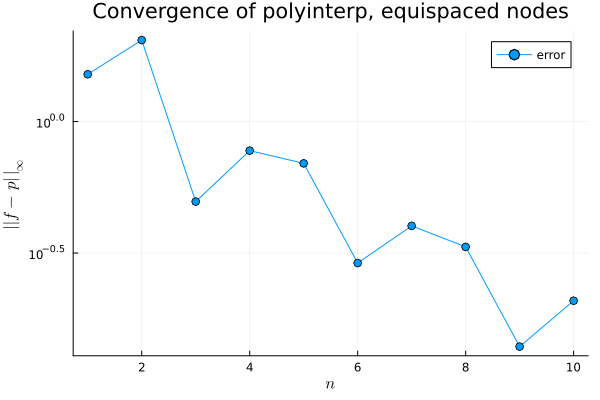

In [158]:
plot(n, maxerr, m=:o, label="error", xaxis=(L"n"),  yaxis=(:log10, L"|| f-p\, ||_\infty"),
    title="Convergence of polyinterp, equispaced nodes")

The maximum pointwise error in the domain does not converge very nicely! Can we do better?

Let's try **Chebyshev nodes**.

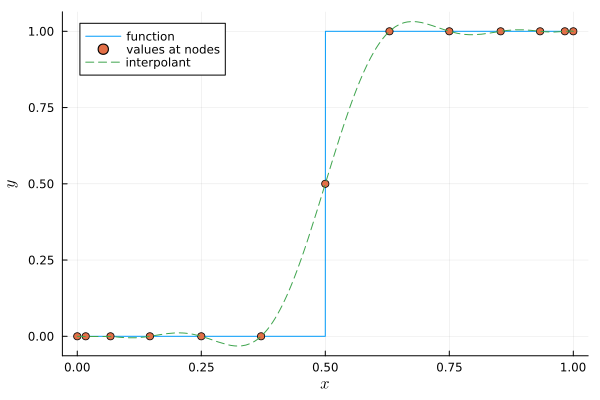

In [81]:
f = x -> exp(sin(7x))
# f = x -> abs(exp(sin(7x)) - 1  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

n = 12; # polynomial degree
t = chebygrid(0, 1, n+1) # n+1 Chebyshev nodes

# Do it by hand
# c = vandermonde(t,f.(t))
# p = Polynomial(c)

# Alternatively, use BasicInterpolators functionality
p = ChebyshevInterpolator(f, 0, 1, n+1)

plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")
scatter!(t, f.(t), label="values at nodes")
plot!(x -> p(x), 0, 1, linestyle=:dash, label="interpolant")

In [ ]:
Revisit the max error

In [85]:
f = x -> exp(sin(7x))
# f = x -> abs(exp(sin(7x)) - 1  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 2:20                # polynomial degrees
maxerr = zeros(length(n))
for (k, n) in enumerate(n)
    p = ChebyshevInterpolator(f, 0, 1, n+1) 
    err = @. f(x) - p(x)
    maxerr[k] = norm(err, Inf) # find the largest-ish error in the domain 
end

In [86]:
maxerr

19-element Vector{Float64}:
 2.0411655489417266
 0.9038330151233385
 0.4672734170952002
 0.4698218849814273
 0.20776288239283525
 0.1354175404610114
 0.09882405773480873
 0.035670361092997815
 0.027933777435151796
 0.01737667690487199
 0.0039093208964437465
 0.004842816085826929
 0.0023783325466812943
 0.0007670963760042504
 0.0007249137802052275
 0.000265637488659376
 0.00013766806878656723
 9.289894143416078e-5
 2.4273740599600746e-5

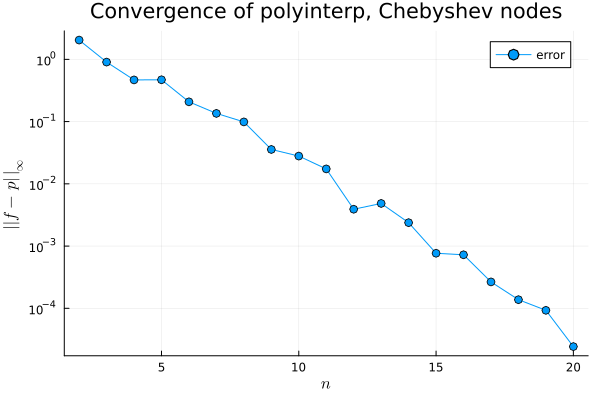

In [87]:
plot(n, maxerr, m=:o, label="error", xaxis=(L"n"),  yaxis=(:log10, L"|| f-p\, ||_\infty"),
    title="Convergence of polyinterp, Chebyshev nodes")

This error looks linear on a log-linear scale! The error is thus of the form $$ e := \|f - p \|_\infty \leq C k^{-n},$$ for some constants $C, k > 0$ and the polynomial degree $n$. Thus $\log e = \log C - n \log k$. This is known as _spectral_ or _exponential_ convergence: a constant factor ($k$) reduction in the error with each increment of $n$. Contrast this behavior with what we observed earlier: _algebraic convergence_, where $e = \mathcal{O}(h^{-\alpha})$ for some grid spacing $h$ and exponent $\alpha > 0$. Algebraic convergence is much slower. Algebraic convergence yields linear error plots on a log-log scale, while spectral convergence yields linear error plots on a log-linear scale.

Chebyshev interpolation yields algebraic convergence only for very smooth functions, specifically what are called _analytic functions_. A necessary (but not sufficient) condition for real analyticity is that the function be infinitely differentiable.

# Aside: basis functions for polynomial interpolation

We don't need to use the monomial basis; in fact it is much better not to! We will get into this later: different polynomial bases, for the _same_ polynomial space, can yield much a better conditioned Vandermonde matrix and better conditioning in general.

One seemingly attractive basis is the Lagrange polynomials defined by a set of nodes. Numerically, these are actually unstable, but they can be useful for theory and are a global polynomial analog of the "hat functions" we saw in the last lecture.

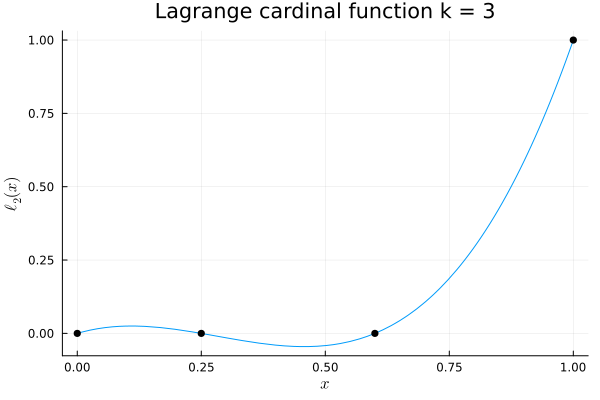

In [140]:
t = [ 0, 0.25, 0.6, 1.0 ]   # some nodal set
n = length(t) - 1;          # poly degree = number of nodes minus one

k = 3                       # pick one basis function
q(x) = prod(x - t[i] for i in [0:k-1; k+1:n] .+ 1)
ℓₖ(x) = q(x) / q(t[k+1]);

plot(ℓₖ, 0, 1, label=false)
y = zeros(n+1);  y[k+1] = 1
scatter!(t, y, color=:black,
    xaxis=(L"x"),  yaxis=(L"\ell_2(x)"),
    title="Lagrange cardinal function k = $k", label=false)